# 4.1 Defining a Classification Problem

### Binary Classification
During the prediction task, the classification function is applied to a new feature vector, and the output of the classifier represents the class to which the input sample is classified, that is, the predicted label. A perfect classifier predicts, for every possible input, the correct class y.

To have a visual understanding of what's going on, let's consider now a binary classification problem, where every feature has two dimensions (a 2-D problem). Let's first define the input dataset; here the make_classifier method of the Scikit-learn library comes in very handy. It creates a dummy dataset for classification, providing the number of classes, the dimensionality of the problem, and the number of observations as parameters. Additionally, you should specify that each feature is informative (and there are no redundancies) and each class is composed of a single cluster of points:

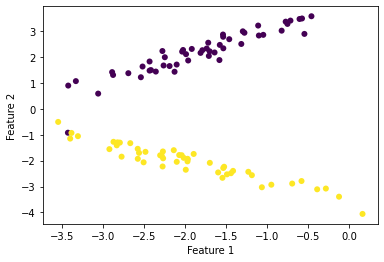

In [1]:
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import make_classification

X, y = make_classification(n_samples=100, n_features=2,
                          n_informative=2, n_redundant=0,
                          n_clusters_per_class=1,
                          class_sep = 2.0, random_state=101)

plt.scatter(X[:, 0], X[:, 1], marker='o', c=y,
            linewidth=0, edgecolor=None)
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.show()

### Assessing a classifiers performance
There is no single metric to define performance since the classification goal can be different—for example, the correctness or completeness of a defined label, minimization of the number of misclassifications, correct ordering in respect of the likelihood of having a certain label, and quite a few others. 

All the measures can be derived from the classification matrix after having applied a cost matrix: the outcome highlights which errors are more expensive and which are not so expensive in terms of results.

 Although it is not a measure of performance, let's start from the confusion matrix, the simplest metric that gives us a visual impact of the correct classifications and the misclassification errors for each class. On the rows there are the true labels, on the column the predicted one. Let's also create a dummy label set and a predicted set for the following experiments. In our example the original labels are six 0 and four 1; the classifier misclassified entries are two 0 and one 1:

In [2]:
y_orig = [0,0,0,0,0,0,1,1,1,1]
y_pred = [0,0,0,0,1,1,1,1,1,0]

from sklearn.metrics import confusion_matrix
conf_mat = confusion_matrix(y_orig,y_pred)
conf_mat

array([[4, 2],
       [1, 3]], dtype=int64)

From the Matrix we can extract some evidence
- The number of samples is 10 (sum of the whole matrix)
- The number of samples labeled "0" in the original is 6; number of "1" samples are 4 (the sum for the lines). These numbers are named support.
- The number of samples labeled "0" in the predicted dataset is 5; "1" is 5 (the sum as columns).
- Correct classifications are 7 (sum of the diagonal)
- misclassifications are 3 (sum of numbers not in the diagonal)
A perfect classification would have all numbers on the diagonal and zeros everywhere else


The matrix can also be represented graphically using a heatmap. This is a very impactful representation, especially when dealing with multiclass problems

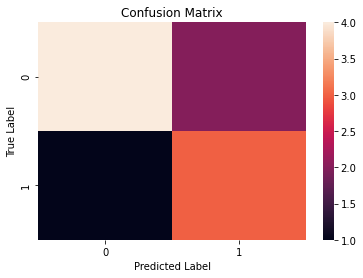

In [3]:
sns.heatmap(conf_mat)
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

### Measuring Accuracy of a classifier
Accuracy is the percentage of correct classificatoins, over the total number of samples. You can derive this error measure directly from the confusion matrix by dividing the sum of the diagonal by the sum of the entire matrix. 

In [4]:
from sklearn.metrics import accuracy_score
accuracy_score(y_orig, y_pred)

0.7

### Measuring Precision of a classifier
Precision considers only one label and counts the percentage of correct classifications on that label. While considering our label "1", the precision is the number in the bottom right of the matrix, divided by the sum of the elements in the second column

Scikit-learn expects a binary input, where only the class under examination is marked as "True" (sometimes called a class indicator. To extract a precision score for each label, you should then make each class a binary vector.

In [5]:
from sklearn.metrics import precision_score
precision_score(y_orig, y_pred)

0.6

### Recall - often paired with precision
precision is about the quality of what you got (quality of results marked with a "1"), <b>recall</b> is about the quality of what you <b>could</b> have gotten (how many instances of "1" you've been able to extract properly). Also, here, this measure is class-based, and to compute the recall score for class 1 you should divide the bottom right number in the confusion matrix by the sum of the second line

Recall is bounded 0 and 1; the best score is 1 and means that all the instances of "1" in the original dataset have been correctly classified as "1"; a score equal to 0 means that no "1"s have been classified properly:

In [6]:
from sklearn.metrics import recall_score
recall_score(y_orig, y_pred)

0.75

Precision and recall are two metrics that indicate how well the classifier performed on a class. Merge their score using a harmonic average, and you'll get the comprehensive f1-score, helping you figure out at a glance the performance on both error measures. 

In [7]:
from sklearn.metrics import f1_score
f1_score(y_orig, y_pred)

0.6666666666666665

In conclusion, if there are so many error scores, which is the best to use? The solution is not very easy, and often it is better to have and evaluate the classifier on all of them. How can we do that? Is it a long function to write? No, Scikit-learn here comes to help us here, providing a method to compute all these scores for each class (this is really handy). Here is how it works:

In [8]:
from sklearn.metrics import classification_report
print(classification_report(y_orig, y_pred))

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.60      0.75      0.67         4

    accuracy                           0.70        10
   macro avg       0.70      0.71      0.70        10
weighted avg       0.72      0.70      0.70        10



# 4.2 Defining a probability-based approach

Logistic Regression is a classifier, but its name recalls a regressor. The element we need to join the pieces is the probabilistic interpretation.

In a binary classification problem the output can either be "0" or a "1". What if we check the probability of the label belonging to class "1"? More specifically, a classification problem can be seen as: given the feature vector, find the class (either 0 or 1) that maximizes the conditional probability:


Here's the connection: if we compute a probability, the classification problem <i>looks</i> like a a regression problem. In the regression problem, classes are no longer "1" or "0" (as strings), but 1.0 and 0.0 (as the probability of belonging to class "1").

Fit a multiple linear regressor on a dummy classification problem, using a probabilistic interpretation. Reuse the same dataset we created earlier, but split into train and test sets. Also, convert the y vector to floating point values

In [9]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y.astype(float),
                                                   test_size=0.33, random_state=101)

y_test

array([0., 1., 1., 0., 0., 1., 0., 1., 1., 1., 0., 1., 1., 0., 0., 0., 1.,
       0., 1., 0., 0., 0., 1., 1., 1., 1., 1., 1., 0., 1., 0., 1., 0.])

now, a value of 1.0 means the observation is 100% class 1, and 0.0 means it is 0% class 1. 

In [10]:
from sklearn.linear_model import LinearRegression
regr = LinearRegression()
regr.fit(X_train, y_train)
regr.predict(X_test)

array([-0.19021825,  1.14481132,  1.16345687,  0.00906543,  0.17492642,
        0.75010591,  0.01764075,  0.69408067,  0.99490823,  0.98471815,
        0.01184894,  0.91408215,  0.77985749,  0.66302112,  0.04339816,
        0.19057929,  1.19126856,  0.01473595,  0.80911677, -0.03827048,
       -0.08450995, -0.22769924,  0.57176711,  0.75836004,  1.02104676,
        1.06148483,  0.873505  ,  1.04779876, -0.1655144 ,  0.66570701,
       -0.01700988,  1.03270133,  0.00856569])

The output—that is, the prediction of the regressor—should be the probability of belonging to class 1. As you can see in the last cell output, that's not a proper probability, since it contains values below 0 and greater than 1. The simplest idea here is clipping results between 0 and 1, and putting a threshold at 0.5: if the value is >0.5, then the predicted class is "1"; otherwise the predicted class is "0".

This procedure works, but we can do better. We've seen how easy it is to transit from a classification problem to a regression one, and then go back with predicted values to predicted classes. With this process in mind, let's again start the analysis, digging further in its core algorithm while introducing some changes.

In our dummy problem, we applied the linear regression model to estimate the probability of the observation belonging to class "1". The regression model was (as we've seen in the previous lesson):

Now, we've seen that the output is not a proper probability. To be a probability, we need to do the following:
- Bound the output between 0.0 and 1.0 (clipping).
- If the prediction is equal to the threshold (we chose 0.5 previously), the probability should be 0.5 (symmetry).

To have both conditions true, the best we could do is to send the output of the regressor through a sigmoid curve, or an S-shaped curve. A sigmoid generically maps values in R (the field of real numbers) to values in the range [0,1], and its value when mapping 0 is 0.5.

On the basis of such a hypothesis, we can now write (for the first time) the formula underneath the logistic regression algorithm.

Note also that the weight W[0] (the bias weight) will take care of the misalignment of the central point of the sigmoid (it's in 0, whereas the threshold is in 0.5).

That's all. That's the logistic regression algorithm. There is just one thing missing: why logistic? What's the σ function?

Well, the answer to both questions is trivial: the standard choice of sigma is the logistic function, also named the inverse-logit function:

 
Although there are infinite functions that satisfy the sigmoid constraints, the logistic has been chosen because it's continuous, easily differentiable, and quick to compute. If the results are not satisfactory, always consider that, by introducing a couple of parameters, you can change the steepness and the center of the function.

The sigmoid function is quickly drawn:

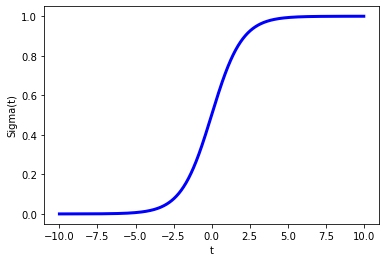

In [11]:
def model(x):
    return 1/(1+np.exp(-x))

x_vals = np.linspace(-10,10,1000)
plt.plot(x_vals, model(x_vals), color='b', linewidth=3)
plt.ylabel('Sigma(t)')
plt.xlabel('t')

plt.show()

You can immediately see that, for a very low t, the function tends to the value 0; for a very high t, the function tends to be 1, and, in the center, where t is 0, the function is 0.5. Exactly the sigmoid function we were looking for.


### More on logistic and logit functions
Now, why did we use the inverse of the logit function? Isn't there anything better than that? The answer to this question comes from statistics: we're dealing with probabilities, and the logit function is a great fit. In statistics, the logit function applied to a probability, returns the log-odds:

This function transforms numbers from range [0,1] to numbers in (−∞, +∞).

### Let's see some code
Start with the dummy dataset we already created. 

In [12]:
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression()
clf.fit(X_train, y_train.astype(int)) # not regression, so label vector must be integers (class indexes)
y_clf = clf.predict(X_test)

print(classification_report(y_test, y_clf))

              precision    recall  f1-score   support

         0.0       1.00      0.93      0.97        15
         1.0       0.95      1.00      0.97        18

    accuracy                           0.97        33
   macro avg       0.97      0.97      0.97        33
weighted avg       0.97      0.97      0.97        33



<ipython-input-13-624d100a9c21>:15: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(xx, yy, Z, cmap=plt.cm.summer)


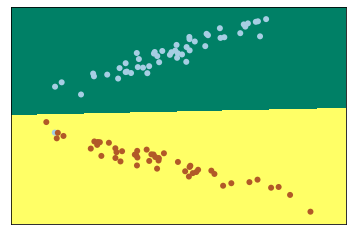

In [13]:
# Example based on:
# Code source: Gaël Varoquaux, Modified for documentation by Jaques Grobler, License: BSD 3 clause

h = .02  # step size in the mesh

# Plot the decision boundary. For that, we will assign a color to each
# point in the mesh [x_min, m_max]x[y_min, y_max].
x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5
y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.pcolormesh(xx, yy, Z, cmap=plt.cm.summer)

# Plot also the training points
plt.scatter(X[:, 0], X[:, 1], c=y, edgecolors='k', linewidth=0, cmap=plt.cm.Paired)

plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())
plt.xticks(())
plt.yticks(())

plt.show()

Let's now see the bare probabilities and the weight vector. To compute the probability, you need to use the predict_proba method of the classifier. It returns two values for each observation: the first is the probability of being of class "0"; the second the probability for class "1". Since we're interested in class "1", here we just select the second value for all the observations:

<ipython-input-14-1459f3b0adad>:3: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(xx, yy, Z, cmap=plt.cm.autumn)
<ipython-input-14-1459f3b0adad>:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = plt.axes()


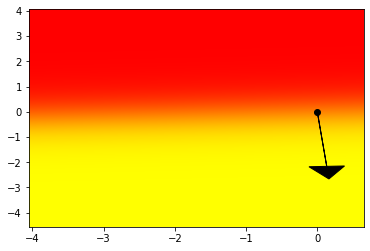

In [14]:
Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:,1]
Z = Z.reshape(xx.shape)
plt.pcolormesh(xx, yy, Z, cmap=plt.cm.autumn)

ax = plt.axes()
ax.arrow(0, 0, clf.coef_[0][0], clf.coef_[0][1], head_width=0.5, 
head_length=0.5, fc='k', ec='k')
plt.scatter(0, 0, marker='o', c='k')

plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())

plt.show()

Lastly, I'd want to focus on speed. Let's now see how much time the classifier takes to train and to predict the labels:

In [15]:
%timeit clf.fit(X,y)

5.13 ms ± 231 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [16]:
%timeit clf.predict(X)

85.9 µs ± 10.5 µs per loop (mean ± std. dev. of 7 runs, 10000 loops each)


In [17]:
%timeit clf.predict_proba(X)

100 µs ± 12.2 µs per loop (mean ± std. dev. of 7 runs, 10000 loops each)


### Pros and cons of Logistic Regression

Logistic Regression is a very popular algorithm becuase of the following:
- it's linear: its the equivelant of the linear regression for classification
- its very simple to understand, and the output can be the most likely class, or the probability of membership
- its simple to train: it has very few coefficients (one for each feature plus a bias). this makes the model very small to store
- Its computationally efficient: using some special tricks, it can be trained very quickly
- it has an extension for multiclass classification

Unfortunately, its not a perfect classifier and has some drawbacks:
- its often not very performant, compared to most advanced algorithms, because it tends to underfit (no flexibility: the boundary has to be a a line or a hyperplane)
- it's linear, if the problem is non-linear, there is no way to properly fit this classifier onto the dataset

# 4.4 Multiclass Logistic Regression
The base algorithm is named One-vs-rest, or One-vs-all, and it's simple to grasp and apply.

Let's describe it with an example: we have to classify three kinds of flowers and, given some features, the possible outputs are three classes: f1, f2, and f3. That's not what we've seen so far; in fact, this is not a binary classification problem. Instead, it seems very easy to break down this problem into three simpler problems:

- Problem #1: Positive examples (that is, the ones that get the label "1") are f1; negative examples are all the others
- Problem #2: Positive examples are f2; negative examples are f1 and f3
- Problem #3: Positive examples are f3; negative examples are f1 and f2

For all three problems, we can use a binary classifier, as Logistic Regressor, and, unsurprisingly, the first classifier will output P(y = f1|x); the second and the third will output respectively P(y = f2|x) and P(y = f3|x).

To make the final prediction, we just need to select the classifier that emitted the highest probability. Having trained three classifiers, the feature space is not divided in two subplanes, but according to the decision boundary of the three classifiers.

Lets work a multiclass classification example

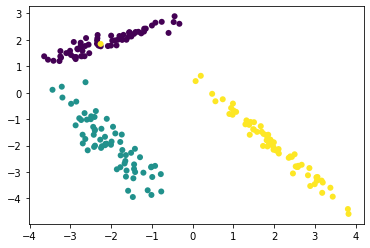

In [18]:
%reset -f
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification

X, y = make_classification(n_samples=200, n_features=2,
                           n_classes=3, n_informative=2,
                           n_redundant=0, n_clusters_per_class=1,
                           class_sep=2.0, random_state=101)
plt.scatter(X[:,0], X[:,1], marker='o', c=y, linewidth=0, edgecolor=None)
plt.show()

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y.astype(float),
                                  test_size=0.33, random_state=101)

from sklearn.linear_model import LogisticRegression

clf = LogisticRegression()
clf.fit(X_train, y_train.astype(int))
y_clf = clf.predict(X_test)

from sklearn.metrics import classification_report
print(classification_report(y_test, y_clf))

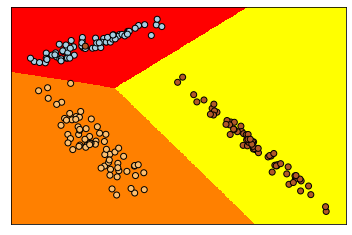

In [22]:
import numpy as np

h = .02  # step size in the mesh

x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5
y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.pcolormesh(xx, yy, Z, cmap=plt.cm.autumn)

# Plot also the training points
plt.scatter(X[:, 0], X[:, 1], c=y, edgecolors='k', cmap=plt.cm.Paired)
plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())
plt.xticks(())
plt.yticks(())

plt.show()

On this dummy dataset, the classifier has achieved a perfect classification (precision, recall, and f1-score are all 1.0). In the last picture, you can see that the decision boundaries define three areas, and create a non-linear division.

Finally, let's observe the first feature vector, its original label, and its predicted label (both reporting class "0"):

In [25]:
print(X_test[0])
print(y_test[0])
print(y_clf[0])

[-3.26744968  1.19639333]
0.0
0


To get its probabilities to belong to each of the three classes, you can simply apply the predict_proba method (exactly as in the binary case), and the classifier will output the three probabilities. Of course, their sum is 1.0, and the highest value is, naturally, one for class "0"

In [35]:
clf.predict_proba(X_test)[0]

array([0.85126747, 0.13897348, 0.00975905])

# 4.5 An Example
We now look at a practical example, containing what we've seen so far

Our data set is articial and has 10,000 observations and 10 features, all of them informative (no redundancies) and labels "0" and "1" (binary classification). Having all the informative features is not an unrealistic hypothesis in machine learning, since usually the feature selection or feature reduction operation selects non-related features.

In [37]:
X, y = make_classification(n_samples=10000, n_features=10,
                           n_informative=10, n_redundant=0,
                           random_state=101)

#### Using statsmodes.api
We'll use Statsmodel. After having loaded the right modules, we need to add an additional feature to the input set in order to have the bias weight W[0]. After that, training the model is really simple: we just need to instantiate a logit object and use its fit method. Statsmodel will train the model and will show whether it was able to train a model (Optimization terminated successfully) or it failed:

In [38]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

Xc = sm.add_constant(X)
logistic_regression = sm.Logit(y, Xc)
fitted_model = logistic_regression.fit()

Optimization terminated successfully.
         Current function value: 0.438685
         Iterations 7


To get a detailed insight into the model, use the method summary

In [39]:
fitted_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                10000
Model:                          Logit   Df Residuals:                     9989
Method:                           MLE   Df Model:                           10
Date:                Wed, 17 Feb 2021   Pseudo R-squ.:                  0.3671
Time:                        20:22:15   Log-Likelihood:                -4386.8
converged:                       True   LL-Null:                       -6931.5
Covariance Type:            nonrobust   LLR p-value:                     0.000
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.4299      0.039     11.023      0.000       0.353       0.506
x1             0.0671      0.015      4.410      0.000       0.037       0.097
x2            -0.7828      0.019    -41.947      0.000      -0.819      -0.746
x3             0.1221      0.016      7.815      0.000       0.091       0.153
x4             0.2841      0.016     18.150      0.000       0.253       0.315
x5             0.1469      0.014     10.283      0.000       0.119       0.175
x6            -0.3414      0.019    -17.636      0.000      -0.379      -0.303
x7             0.0503      0.014      3.481      0.000       0.022       0.079
x8            -0.1393      0.014     -9.642      0.000      -0.168      -0.111
x9             0.1127      0.014      7.931      0.000       0.085       0.141
x10           -0.4792      0.018    -27.340      0.000      -0.514      -0.445
==============================================================================
"""

Two tables are returned: the first one is about the dataset and model performances; the second is about the weights of the model. Statsmodel provides a lot of information on the model; some of it has been shown in Lesson 2, Approaching Simple Linear Regression, about a trained regressor. Here, instead, we have a brief description of the information shown for the classifier:
- Converged: This tells whether the classification model has reached convergence while being trained. Use the model only if this parameter is true.
- Log-Likelihood: This is the logarithm of the likelihood. It's what we previously named.
- LL-Null: This is the Log-Likelihood when only the intercept is used as a predictor.
- LLR p-value: This is the chi-squared probability of getting a log-likelihood ratio statistically greater than LLR. Basically, it shows how the model is better than guessing with a constant value. LLR is the log-likelihood ratio, that is, the logarithm of the likelihood of the null model (intercept only), divided by the likelihood of the alternate model (full model).
- Pseudo R-squared: This can be seen as the proportion of the total variability unexplained by the model. It's computed as 1-Log-likelihood/LL-Null.

As for the coefficient table, there is one line for each coefficient: const is the weight associated to the intercept term (that is, the bias weight); x1, x2, … x10 are the weights associated to the 10 features composing the model. For each of them there are a few values:
- Coef: This is the weight in the model associated to that feature.
- Std err: This is the standard error of the coefficient, that is its (predicted) standard deviation (across all observations) divided by the square root of the sample size.
- Z: This is the ratio between the standard error and the coefficient (it's the stat t-value).
- P>|z|: This is the probability of obtaining a t-value greater than z, while sampling from the same population.
- [95.0% Conf. Int.]: This is the interval where, with 95% confidence, the real value of the coefficient is. It is computed as coefficient +/- 1.96 * std err.

#### Using statsmodels.formula.api
An alternate method to obtain the same result (often used when the model contains a small number of features) is to write down the formula involved in the regression. This is possible thanks to the Statsmodel formula API, which makes the fitting operation similar to what you would use in R. We first need to name the features, then we write down the formula (using the names we set), and lastly we fit the model. With this method, the intercept term is automatically added to the model. Its output, then, is the same as the preceding output:

In [40]:
import pandas as pd

Xd = pd.DataFrame(X)
Xd.columns = ['VAR'+str(i+1) for i in range(10)]
Xd['response'] = y

logistic_regression = smf.logit(formula = 
    'response ~ VAR1+ VAR2 + VAR3 + VAR4 + \
    VAR5 + VAR6 + VAR7 + VAR8 + VAR9 + VAR10', data=Xd)

fitted_model = logistic_regression.fit()
fitted_model.summary()

Optimization terminated successfully.
         Current function value: 0.438685
         Iterations 7


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:               response   No. Observations:                10000
Model:                          Logit   Df Residuals:                     9989
Method:                           MLE   Df Model:                           10
Date:                Wed, 17 Feb 2021   Pseudo R-squ.:                  0.3671
Time:                        20:35:07   Log-Likelihood:                -4386.8
converged:                       True   LL-Null:                       -6931.5
Covariance Type:            nonrobust   LLR p-value:                     0.000
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.4299      0.039     11.023      0.000       0.353       0.506
VAR1           0.0671      0.015      4.410      0.000       0.037       0.097
VAR2          -0.7828      0.019    -41.947      0.000      -0.819      -0.746
VAR3           0.1221      0.016      7.815      0.000       0.091       0.153
VAR4           0.2841      0.016     18.150      0.000       0.253       0.315
VAR5           0.1469      0.014     10.283      0.000       0.119       0.175
VAR6          -0.3414      0.019    -17.636      0.000      -0.379      -0.303
VAR7           0.0503      0.014      3.481      0.000       0.022       0.079
VAR8          -0.1393      0.014     -9.642      0.000      -0.168      -0.111
VAR9           0.1127      0.014      7.931      0.000       0.085       0.141
VAR10         -0.4792      0.018    -27.340      0.000      -0.514      -0.445
==============================================================================
"""

#### Scikit-learn 
Scikit-learn has two implementations: one based on the classic solution of the logistic regression optimization, and the other one based on a quick SGD implementation. We'll explore them both.

First, we start with the classic Logistic Regression implementation. The training is really simple, and just requires a couple of parameters. We will set its parameters to the extreme, so the solution is not regularized (C is very high) and the stopping criterion on tolerance is very low. We do that in this example to get the same weights in the model; in a real experiment, these parameters will guide hyperparameter optimization. For more information about regularization, please refer to Lesson 6, Achieving Generalization:

##### Using the classic method

In [41]:
from sklearn.linear_model import LogisticRegression

clf = LogisticRegression(C=1e4, tol=1e-25, random_state=101)
clf.fit(X, y)

LogisticRegression(C=10000.0, random_state=101, tol=1e-25)

In [42]:
coeffs = [clf.intercept_[0]]
coeffs.extend(clf.coef_[0])
coeffs

[0.4299012423792896,
 0.06707352255219642,
 -0.7828068660348312,
 0.12207683046267787,
 0.28410515323465413,
 0.14689221213394843,
 -0.34142784277931676,
 0.05031700448004045,
 -0.13932062352365435,
 0.11267792044953343,
 -0.47917035048372314]

#### Using Standard Gradient Descent in Scikit-learn

In [47]:
from sklearn.linear_model import SGDClassifier

clf = SGDClassifier(loss='log', alpha=1e-4, n_iter_no_change=1e2, random_state=101)
clf.fit(X, y)

SGDClassifier(loss='log', n_iter_no_change=100.0, random_state=101)

In [48]:
coeffs = [clf.intercept_[0]]
coeffs.extend(clf.coef_[0])
coeffs

[0.4689946827992025,
 0.0003320156627665514,
 -0.7282428225698584,
 0.10041705196268749,
 0.3136344890631781,
 0.12452641661307057,
 -0.3144858167803973,
 0.031239324298437413,
 -0.18865677154380453,
 0.10925581628463508,
 -0.49056170762711826]